# Jobsheet 7

Kelompok 6 :

1. Aldin Ariel Pramudya (2141720233)

2. Aryo Deva Saputra (2141720176)

3. Muhammad Ega Rama Fernanda (2141720143)

Kelas : 3D

Prodi : D-IV Teknik Inormatika

Jurusan : Teknologi Inormasi

## Konvulsi tanpa library

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv
import math
from google.colab.patches import cv2_imshow
from PIL import Image as im

In [3]:
def convolution2d(image, kernel, stride, padding):
  # Tambahkan padding pada citra
    padded_image = np.zeros((image.shape[0] + 2*padding, image.shape[1] + 2*padding))
    padded_image[padding:-padding, padding:-padding] = image

    # Inisiasi citra output
    output_height = (image.shape[0] - kernel.shape[0] + 2*padding) // stride + 1
    output_width = (image.shape[1] - kernel.shape[1] + 2*padding) // stride + 1
    output = np.zeros((output_height, output_width))

    for y in range(output_height):
        for x in range(output_width):
            # Posisi kernel pada citra padded
            y0 = y * stride
            x0 = x * stride
            # Element-wise multiplication antara kernel dan patch citra
            k = (kernel * padded_image[y0:y0 + kernel.shape[0], x0:x0 + kernel.shape[1]]).sum()
            output[y,x] = k

    return output

In [2]:
img = cv.imread('/content/drive/MyDrive/Semester 5 Waduh/PCVK/Jobsheet 7/female_2.tiff')
img_gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

In [4]:
kernel_sharpen = np.array([[0,-1,0],
                          [-1,5,-1],
                          [0,-1,0]])

In [5]:
convolution2d(img_gray,kernel_sharpen,1,2)

array([[   0.,  -45.,  -45., ..., -134., -136.,    0.],
       [ -45.,  135.,   92., ...,  271.,  416., -136.],
       [ -45.,   92.,   46., ...,  125.,  253., -130.],
       ...,
       [ -11.,   22.,   13., ...,   82.,  217., -100.],
       [ -18.,   62.,   39., ...,  159.,  306.,  -97.],
       [   0.,  -18.,  -17., ...,  -79.,  -97.,    0.]])

## Image Filter


### Sharpen

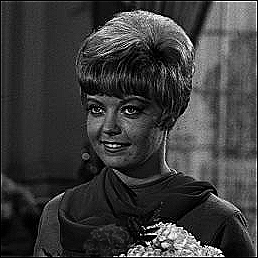

In [13]:
cv2_imshow(convolution2d(img_gray,kernel_sharpen,1,2))

### Emboss

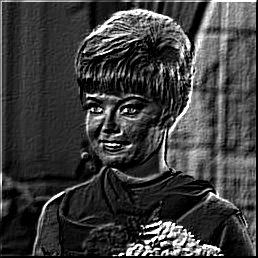

In [15]:
kernel_emboss = np.array([[-2,-1,0],
                          [-1,1,1],
                          [0,1,2]])

cv2_imshow(convolution2d(img_gray,kernel_emboss,1,2))

### Left Sobel Edge Detection

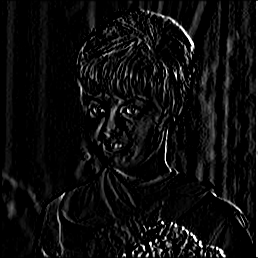

In [16]:
kernel_left_sobel = np.array([[1, 0, -1],
                              [2, 0, -2],
                              [1, 0 , -1]])

cv2_imshow(convolution2d(img_gray,kernel_left_sobel,1,2))

### Canny Edge Detection

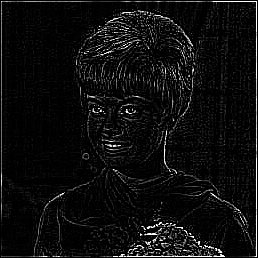

In [17]:
kernel_canny_edge = np.array([[-1, -1, -1],
                              [-1, 8, -1],
                              [-1, -1, -1]])

cv2_imshow(convolution2d(img_gray,kernel_canny_edge,1,2))

### Prewitt Edge Detection


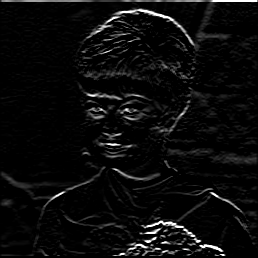

In [18]:
kernel_canny_edge = np.array([[-1, -1, -1],
                              [0, 0, 0],
                              [1, 1, 1]])

cv2_imshow(convolution2d(img_gray,kernel_canny_edge,1,2))

### 5x5 Gaussian Blur

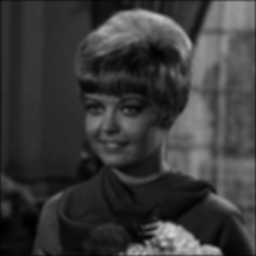

In [19]:
#5x5 Gaussian Blur
kernel_size = 5
sigma = math.sqrt(kernel_size)
gaussian_kernel = cv.getGaussianKernel(kernel_size, sigma)
gauss_kernel = gaussian_kernel @ gaussian_kernel.transpose()

cv2_imshow(convolution2d(img_gray, gauss_kernel, 1, 2))

### 21x21 Gaussian Blur

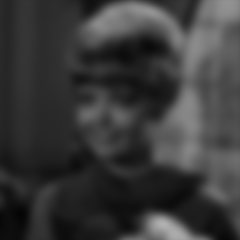

In [20]:
#21x21 Gaussian Blur
kernel_size = 21
sigma = math.sqrt(kernel_size)
gaussian_kernel = cv.getGaussianKernel(kernel_size, sigma)
gauss_kernel = gaussian_kernel @ gaussian_kernel.transpose()

cv2_imshow(convolution2d(img_gray, gauss_kernel, 1, 2))

## Tugas

In [21]:
def gamma_correction(image, gamma):
  inv_gamma = 1 / gamma
  gamma_image = np.zeros(image.shape, image.dtype)

  # Akses per pixel
  for y in range(image.shape[0]):
    for x in range(image.shape[1]):
      for c in range(image.shape[2]):
        gamma_image[y, x, c] = np.clip((image[y, x, c] / 255) ** inv_gamma * 255, 0, 255)

  return gamma_image

def hitung_pixel(image):
  red = {}
  green = {}
  blue = {}

  # Akses per pixel
  for y in range(image.shape[0]):
    for x in range(image.shape[1]):
      b = int(image[y, x, 0])
      g = int(image[y, x, 1])
      r = int(image[y, x, 2])

      if r in red:
        red[r] += 1
      else:
        red[r] = 1

      if g in green:
        green[g] += 1
      else:
        green[g] = 1

      if b in blue:
        blue[b] += 1
      else:
        blue[b] = 1

  return red, green, blue

def histogram_equalization(image):

  # Intensitas Pixel
  intensitas_merah, intensitas_hijau, intensitas_biru = hitung_pixel(image)

  red_channel = hitung_sk(image[...,2], intensitas_merah)
  green_channel = hitung_sk(image[...,1], intensitas_hijau)
  blue_channel = hitung_sk(image[...,0], intensitas_biru)

  merged_image = cv.merge([blue_channel, green_channel, red_channel])

  return merged_image

def hitung_sk(image, list_intensitas):
  list_intensitas = dict(sorted(list_intensitas.items()))

  # l, rj dan nrj
  l = 256
  rj = list(list_intensitas.keys())
  nrj = list(list_intensitas.values())

  # K0
  k0 = []
  for i in range(len(rj)):
    if i == 0:
      k0.append(nrj[i])
    else:
      k0.append(nrj[i] + k0[i - 1])

  # Sk = round((L-1)/MAX(k0) * k0)
  sk = []
  list_pixel_baru = {}
  for i in range(len(rj)):
    k0s = (l - 1) / k0[-1] * k0[i]
    sk.append(round(k0s))

    list_pixel_baru[rj[i]] = sk[i]

  # Konversi nilai pixel
  for y in range(image.shape[0]):
    for x in range(image.shape[1]):
      image[y, x] = list_pixel_baru[image[y, x]]

  return image

kernel_sharpen = np.array([[0, -1, 0],
                          [-1, 5, -1],
                          [0, -1, 0]], dtype=np.float32)

In [26]:
def second_convolution2d(image, kernel):
    tinggi = image.shape[0]
    lebar = image.shape[1]

    tinggi_kernel = kernel.shape[0]
    lebar_kernel = kernel.shape[1]

    start = int(lebar_kernel/2)

    image_result = np.copy(image)

    for y in range(start, tinggi - start):
        for x in range(start, lebar - start):
            value = 0

            for ky in range(tinggi_kernel):
                for kx in range(lebar_kernel):
                    i = y - start + ky
                    j = x - start + kx

                    value += image[i, j] * kernel[ky, kx]

            image_result[y, x] = np.clip(value, 0, 255)

    return image_result

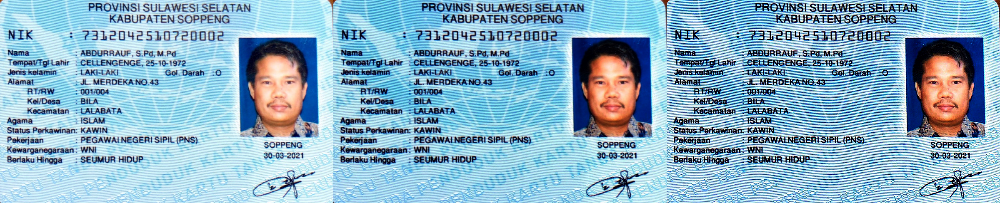

In [27]:
ktp2 = cv.imread('/content/drive/MyDrive/Semester 5 Waduh/PCVK/Jobsheet 7/KTP_More/KTP7.jpeg')
ktp2_copy = np.copy(ktp2)
ktp2_result = gamma_correction(ktp2_copy, 0.6)
ktp2_filtered = second_convolution2d(ktp2_result, kernel_sharpen)

final_frame = cv.hconcat((ktp2, ktp2_result, ktp2_filtered))
cv2_imshow(final_frame)

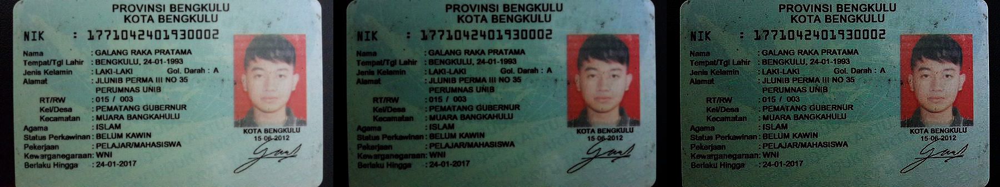

In [29]:
ktp3 = cv.imread('/content/drive/MyDrive/Semester 5 Waduh/PCVK/Jobsheet 7/KTP_More/ktp1.png')
ktp3_copy = np.copy(ktp3)
ktp3_result = gamma_correction(ktp3_copy, 0.5)
ktp3_filtered = second_convolution2d(ktp3_result, kernel_sharpen)

final_frame = cv.hconcat((ktp3, ktp3_result, ktp3_filtered))
cv2_imshow(final_frame)

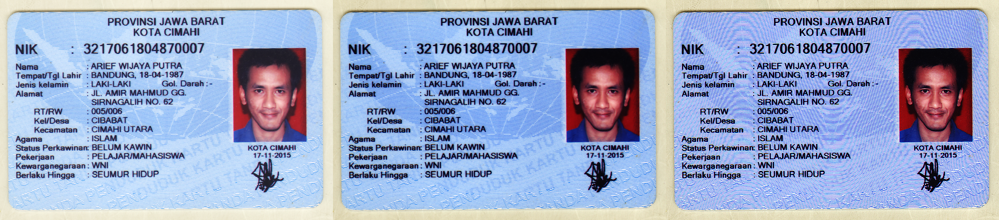

In [30]:
ktp5 = cv.imread('/content/drive/MyDrive/Semester 5 Waduh/PCVK/Jobsheet 7/KTP_More/ktp2.png')
ktp5_copy = np.copy(ktp5)
ktp5_result = gamma_correction(ktp5_copy, 0.6)
ktp5_filtered = second_convolution2d(ktp5_result, kernel_sharpen)

final_frame = cv.hconcat((ktp5, ktp5_result, ktp5_filtered))
cv2_imshow(final_frame)

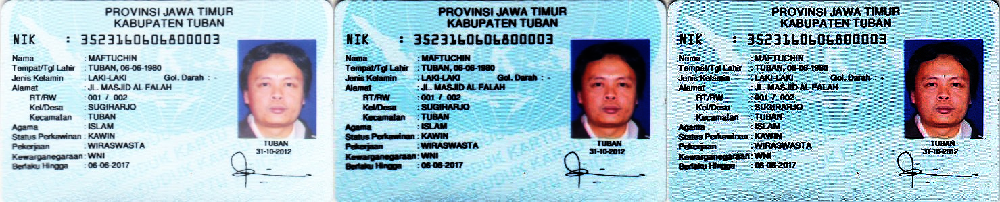

In [32]:
ktp6 = cv.imread('/content/drive/MyDrive/Semester 5 Waduh/PCVK/Jobsheet 7/KTP_More/ktp3.png')
ktp6_copy = np.copy(ktp6)
ktp6_result = gamma_correction(ktp6_copy, 0.3)
ktp6_filtered = second_convolution2d(ktp6_result, kernel_sharpen)

final_frame = cv.hconcat((ktp6, ktp6_result, ktp6_filtered))
cv2_imshow(final_frame)

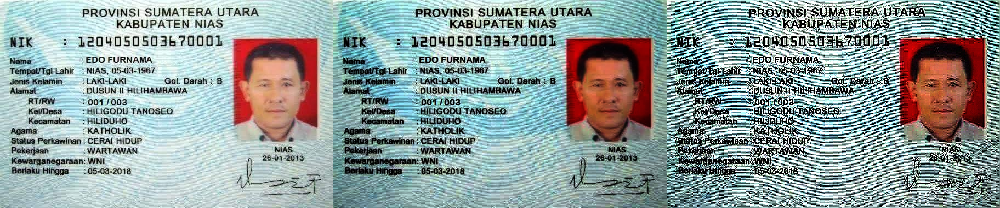

In [34]:
ktp7 = cv.imread('/content/drive/MyDrive/Semester 5 Waduh/PCVK/Jobsheet 7/KTP_More/ktp5.png')
ktp7_copy = np.copy(ktp7)
ktp7_result = gamma_correction(ktp7_copy, 0.48)
ktp7_filtered = second_convolution2d(ktp7_result, kernel_sharpen)

final_frame = cv.hconcat((ktp7, ktp7_result, ktp7_filtered))
cv2_imshow(final_frame)

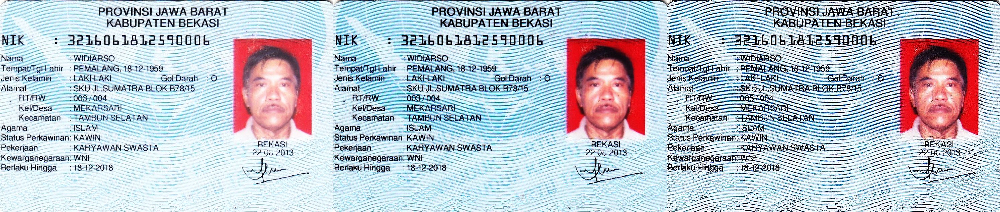

In [36]:
ktp = cv.imread('/content/drive/MyDrive/Semester 5 Waduh/PCVK/Jobsheet 7/KTP_More/ktp6.png')
ktp_copy = np.copy(ktp)
ktp_result = gamma_correction(ktp_copy, 0.5)
ktp_filtered = second_convolution2d(ktp_result, kernel_sharpen)

final_frame = cv.hconcat((ktp, ktp_result, ktp_filtered))
cv2_imshow(final_frame)

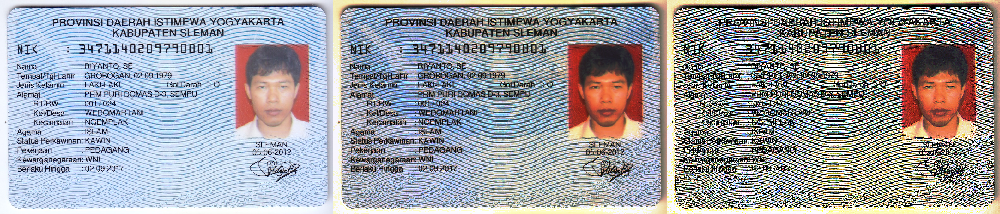

In [38]:
ktp1 = cv.imread('/content/drive/MyDrive/Semester 5 Waduh/PCVK/Jobsheet 7/KTP_More/ktp.png')
ktp1_copy = np.copy(ktp1)
ktp1_result = histogram_equalization(ktp1_copy)
ktp1_result = gamma_correction(ktp1_result, 1.4)
ktp1_filtered = second_convolution2d(ktp1_result, kernel_sharpen)

final_frame = cv.hconcat((ktp1, ktp1_result, ktp1_filtered))
cv2_imshow(final_frame)